In [1]:
import numpy as np
import numpy.linalg as npl
import scipy.interpolate as scpi
import matplotlib.pyplot as plt

import import_ipynb
from Polynome2p1_avecArgumentsF import *
import Fonctions_Test as FT

importing Jupyter notebook from Polynome2p1_avecArgumentsF.ipynb
importing Jupyter notebook from Polynome2p1.ipynb
importing Jupyter notebook from Fonctions_Test.ipynb


In [2]:
# Schema 
def DF_amont(U0,T,dt,dx,c):
    J = int(1/dx) - 1
    t = 0
    U = np.copy(U0)
    while t < T:
        Taum = np.concatenate(([U[-1]],U[:-1]))
        U = U - c*dt/dx * (U - Taum)
        t += dt
    return U

In [3]:
# Traitement de la donnée initiale
def gauss(x,h,origin,sigma):
    x = x*h+origin
    return np.exp(-((x-0.5)**2)/(2*sigma))/(np.sqrt(2*np.pi*sigma**2))

def paquet(x,h,origin,sigma,k):
    return gauss(x,h,origin,sigma)*np.sin(2*k*np.pi*x)

def creneau(x,h,origin,start,end):
    x = (x+origin)*h
    return 1 *(x>=start*h) + 1*(x<=end*h)

def u0(x,h,origin):
    x = (x+origin)*h
    return np.cos(np.pi*x)**2+1

# Test de base sur $cos(\pi x)^2 +1$

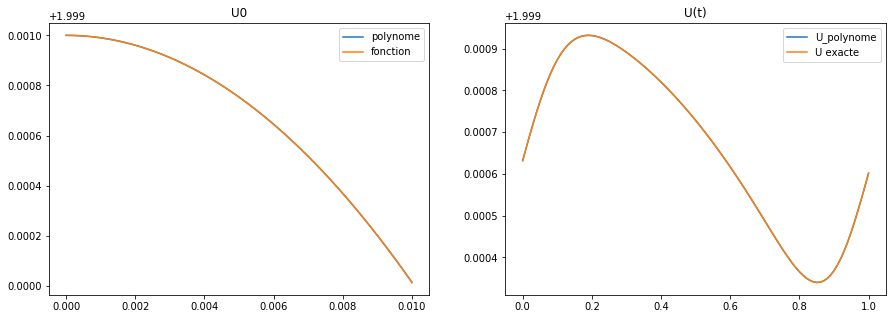

3.9157992600787666e-15


In [4]:
#Parametres du pb
n_points = 100 + 1
x = np.linspace(0,1,n_points)
dx = 1/(n_points-1) 
CFL = 1/2
c = 1
dt = dx*CFL/c
T = 2

#Parametres interpolation
p = 10
f = u0
h = dx
argf = [0] 
epsilon = 1e-5

px,fx,nbiter =  approxh(x,p,f,h,argf,epsilon,init=None,s=1)
U0 = f(x,h,*argf)

U = DF_amont(px,T,dt,dx,c)
Uex = DF_amont(U0,T,dt,dx,c)

plt.figure(figsize=(15,5))

plt.subplot(1,2,1)
plt.plot(x*h,px,label="polynome")
plt.plot(x*h,U0,label="fonction")
plt.legend()
plt.title("U0")

plt.subplot(1,2,2)
plt.plot(x,U,label="U_polynome")
plt.plot(x,Uex,label="U exacte")
plt.legend()
plt.title("U(t)")
plt.show()

print(npl.norm(U-Uex))


In [24]:
if False : 
    import os
    os.mkdir('./tmp/')

In [6]:
import imageio
import os
from IPython.display import HTML
from IPython.display import Image

# Animation
def animation2(init_u,f,argf,top,bottom):
    n_points = 100 + 1
    x = np.linspace(0,1,n_points)
    dx = 1/(n_points-1) 
    CFL = 1/2
    c = 1
    dt = dx*CFL/c
    T = 1
    nb_pas = int(T/dt)   
    h = dx
    if init_u == 1 : 
        U = f(x,h,*argf)
    else : 
        p = 2
        epsilon = 1e-5
        U,fx,nb_iter = approxh(x,p,f,h,argf,epsilon,init=None,s=1)

    for i in range(nb_pas):
        U = DF_amont(U,dt,dt,dx,c)
        plt.plot(x,U)
        plt.ylim(top=top)
        plt.ylim(bottom=bottom)
        plt.savefig("tmp/amont" + str(i) + ".png")
        plt.clf()

    images = []

    for i in range(nb_pas):
        images.append(imageio.imread("tmp/amont" + str(i) + ".png"))
    imageio.mimsave('animation_2.gif', images)

    with open('animation_2.gif','rb') as file:
        display(Image(file.read()))

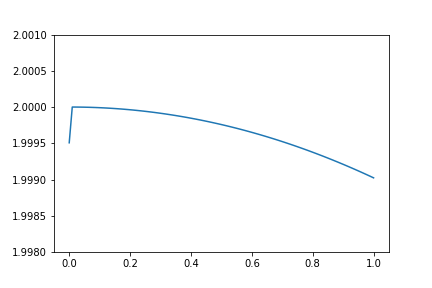

In [7]:
top = 2.001
bottom = 1.998

argf = [0]
f = u0
animation2(1,f,argf,top,bottom)

### Test de base pour la gaussienne

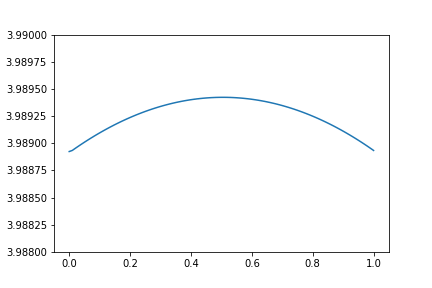

In [8]:
top = 3.99
bottom = 3.988

argf = [0.495,1/10]
f = gauss
animation2(0,f,argf,top,bottom)

# Tests sur plusieurs cellules

### Juste avec des conditions périodiques

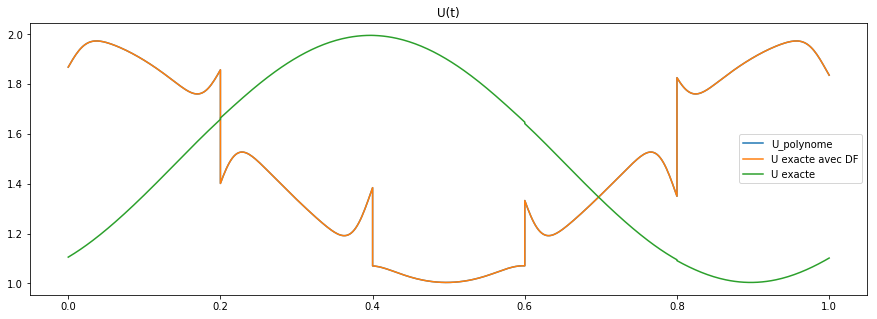

In [9]:
#Donnees du pb
c = 1
T = 2

#Parametres de discretisation
cells_num = 5
n_points = 100 + 1
x = np.linspace(0,1,n_points)
dx = 1/(n_points-1) 
CFL = 1/2
dt = dx*CFL/c

#Parametres interpolation
p = 5
f = u0
h = 1/cells_num
epsilon = 1e-5

U = np.zeros(cells_num*n_points)
Uex = np.zeros(cells_num*n_points)
x_cells = np.zeros(cells_num*n_points)

for i in range (cells_num) :
    origin = i
    x_cell = (x+origin)*h
    x_cells[i*n_points:(i+1)*n_points] = x_cell
    argf = [origin] 
    
    px,fx,nbiter =  approxh(x,p,f,h,argf,epsilon,init=None,s=1)
    U0 = f(x,h,*argf)

    U_cell = DF_amont(px,T,dt,dx,c)
    Uex_cell = DF_amont(U0,T,dt,dx,c)
    U[i*n_points:(i+1)*n_points] = U_cell
    Uex[i*n_points:(i+1)*n_points] = Uex_cell

    #plt.figure(figsize=(15,5))
    """plt.subplot(1,2,1)
    plt.plot(x_cell,px,label="polynome")
    plt.plot(x_cell,U0_cell,label="fonction")
    plt.legend()
    plt.title("U0")

    plt.subplot(1,2,2)
    plt.plot(x_cell,U_cell,label="U_polynome")
    plt.plot(x_cell,Uex_cell,label="U exacte")
    plt.legend()
    plt.title("U(t)")
    plt.show()"""
    #print(npl.norm(U-Uex))

        
U1 = f(x_cells,1,0)
U1 = DF_amont(U1,T,dt,dx,c)
plt.plot(x_cells,U,label="U_polynome")
plt.plot(x_cells,Uex,label="U exacte avec DF")
plt.plot(x_cells,U1,label="U exacte")
plt.legend()
plt.title("U(t)")
plt.show()

C:\Users\gerie\Anaconda3\lib\site-packages\numpy\lib\polynomial.py:732: RuntimeWarning: invalid value encountered in add
  val = a1 + a2
C:\Users\gerie\Anaconda3\lib\site-packages\numpy\lib\polynomial.py:1223: RuntimeWarning: divide by zero encountered in true_divide
  return poly1d(self.coeffs/other)


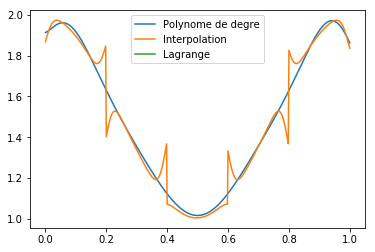

In [10]:
#pour de la reconstruction
import scipy.interpolate as spi

a = np.polyfit(x_cells,U,10)
poly = 0
for i in range (len(a)):
    poly += a[len(a)-i-1] * x_cells**i

    
interp = spi.interp1d(x_cells,U)
lagrange = spi.lagrange(x_cells,U)

plt.plot(x_cells,poly,label="Polynome de degre")
plt.plot(x_cells, interp(x_cells),label="Interpolation")
plt.plot(x_cells, lagrange(x_cells),label="Lagrange")
plt.legend()
plt.show()

### *Test pour une fonction identique sur toutes les cellules*

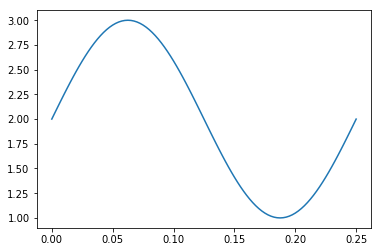

In [11]:
def u0(x,h,origin,cells_num):
    x = (x+origin)*h
    k = 1
    return np.sin(2*np.pi*x*k*cells_num) + 2 

plt.plot((x+0)*1/4,u0(x,1/4,0,4))

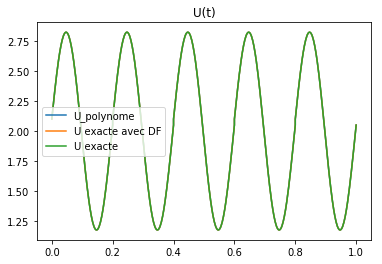

In [12]:
#Donnees du pb
c = 1
T = 2

#Parametres de discretisation
cells_num = 5
n_points = 100 + 1
x = np.linspace(0,1,n_points)
dx = 1/(n_points-1) 
CFL = 1/2
dt = dx*CFL/c

#Parametres interpolation
p = 10
f = u0
h = 1/cells_num
epsilon = 1e-5

U = np.zeros(cells_num*n_points)
Uex = np.zeros(cells_num*n_points)
x_cells = np.zeros(cells_num*n_points)

for i in range (cells_num) :
    origin = i
    x_cell = (x+origin)*h
    x_cells[i*n_points:(i+1)*n_points] = x_cell
    argf = [origin,cells_num] 
    
    px,fx,nbiter =  approxh(x,p,f,h,argf,epsilon,init=None,s=1)
    U0 = f(x,h,*argf)

    U_cell = DF_amont(px,T,dt,dx,c)
    Uex_cell = DF_amont(U0,T,dt,dx,c)
    U[i*n_points:(i+1)*n_points] = U_cell
    Uex[i*n_points:(i+1)*n_points] = Uex_cell
    
   #print(npl.norm(U-Uex))

U1 = f(x_cells,1,0,cells_num)
U1 = DF_amont(U1,T,dt,dx,c)
plt.plot(x_cells,U,label="U_polynome")
plt.plot(x_cells,Uex,label="U exacte avec DF")
plt.plot(x_cells,U1,label="U exacte")
plt.legend()
plt.title("U(t)")
plt.show()

In [13]:
import imageio
import os
from IPython.display import HTML
from IPython.display import Image

# Animation
def animation3(init_u,top,bottom):
    #Donnees du pb
    c = 1
    T = 2
    #Parametres de discretisation
    cells_num = 5
    n_points = 100 + 1
    x = np.linspace(0,1,n_points)
    dx = 1/(n_points-1) 
    CFL = 1/2
    dt = dx*CFL/c
    #Parametres interpolation
    p = 10
    f = u0
    h = 1/cells_num
    epsilon = 1e-5
    
    # init
    U = np.zeros(cells_num*n_points)
    x_cells = np.zeros(cells_num*n_points)
    for i in range (cells_num) :
        origin = i
        x_cell = (x+origin)*h
        x_cells[i*n_points:(i+1)*n_points] = x_cell
        argf = [origin,cells_num] 
        if init_u == 1 : 
            U[i*n_points:(i+1)*n_points] = f(x,h,*argf)
        else : 
            p = 5
            epsilon = 1e-5
            U[i*n_points:(i+1)*n_points],fx,nb_iter = approxh(x,p,f,h,argf,epsilon,init=None,s=1)
    # iterations en temps
    for t in range(n_points):
        for i in range (cells_num) :          
            U[i*n_points:(i+1)*n_points] = DF_amont(U[i*n_points:(i+1)*n_points],dt,dt,dx,c)
        
        plt.plot(x_cells,U)
        plt.ylim(top=top)
        plt.ylim(bottom=bottom)
        plt.savefig("tmp/amont" + str(t) + ".png")
        plt.clf()

        
        
    images = []

    for i in range(n_points):
        images.append(imageio.imread("tmp/amont" + str(i) + ".png"))
    imageio.mimsave('animation_3.gif', images)

    with open('animation_3.gif','rb') as file:
        display(Image(file.read()))

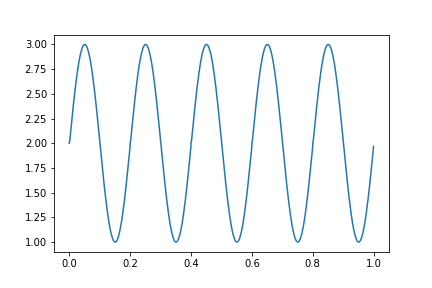

In [14]:
top = 3.1
bottom = 0.9

animation3(1,top,bottom)

C:\Users\gerie\Anaconda3\lib\site-packages\numpy\lib\polynomial.py:732: RuntimeWarning: invalid value encountered in add
  val = a1 + a2
C:\Users\gerie\Anaconda3\lib\site-packages\numpy\lib\polynomial.py:1223: RuntimeWarning: divide by zero encountered in true_divide
  return poly1d(self.coeffs/other)


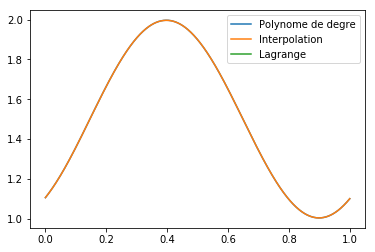

In [25]:
#pour la reconstruction
import scipy.interpolate as spi

a = np.polyfit(x_cells,U,10)
poly = 0
for i in range (len(a)):
    poly += a[len(a)-i-1] * x_cells**i

    
interp = spi.interp1d(x_cells,U)
lagrange = spi.lagrange(x_cells,U)

plt.plot(x_cells,poly,label="Polynome de degre")
plt.plot(x_cells, interp(x_cells),label="Interpolation")
plt.plot(x_cells, lagrange(x_cells),label="Lagrange")
plt.legend()
plt.show()

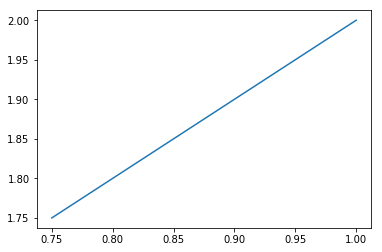

In [16]:
def affine(x,h,a):
    x = (x+a)*h
    return x+1

x = np.linspace(0,1,10)
h = 1/4
a = 3
plt.plot(x*h+a*h,affine(x,h,a))

# Essai avec conditions périodiques sur les bords 0 et 1 seulement

In [17]:
def u0(x,h,origin):
    x = (x+origin)*h
    return np.cos(np.pi*x)**2+1

In [18]:
# Schema 
def DF_amont_2(U0,dt,dx,c,cond):
    U = np.copy(U0)
    Taum = np.concatenate(([cond],U[:-1]))
    U = U - c*dt/dx * (U - Taum)
    return U

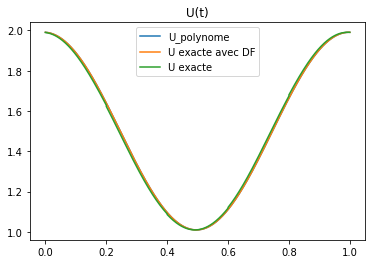

In [19]:
#Donnees du pb
c = 1
T = 5

#Parametres de discretisation
cells_num = 5
n_points = 100 + 1
x = np.linspace(0,1,n_points)
dx = 1/(n_points-1) 
CFL = 1/2
dt = dx*CFL/c

#Parametres interpolation
p = 5
f = u0
h = 1/cells_num
epsilon = 1e-5

U = np.zeros(cells_num*n_points)
Uex = np.zeros(cells_num*n_points)
U0 = np.zeros(cells_num*n_points)
U0ex = np.zeros(cells_num*n_points)
x_cells = np.zeros(cells_num*n_points)

#init
for i in range (cells_num) :
    origin = i
    x_cell = (x+origin)*h
    x_cells[i*n_points:(i+1)*n_points] = x_cell
    argf = [origin] 
    Uex[i*n_points:(i+1)*n_points] = f(x,h,*argf)
    U[i*n_points:(i+1)*n_points],fx,nb_iter = approxh(x,p,f,h,argf,epsilon,init=None,s=1)
    U0 = np.copy(U)
    U0ex = np.copy(Uex)
    
#en temps
for t in range (int(T//dt)):
    for i in range (cells_num) :
        if i == 0 :
            cond = U0[-1]
            condex = U0ex[-1]
        else : 
            cond = U0[i*n_points-2]
            condex = U0ex[i*n_points-2]
           
        U_cell = DF_amont_2(U[i*n_points:(i+1)*n_points],dt,dx,c,cond)
        Uex_cell = DF_amont_2(Uex[i*n_points:(i+1)*n_points],dt,dx,c,condex)

        U0[i*n_points:(i+1)*n_points]  = U[i*n_points:(i+1)*n_points]
        U0ex[i*n_points:(i+1)*n_points]  = Uex[i*n_points:(i+1)*n_points]
        
        U[i*n_points:(i+1)*n_points] = U_cell
        Uex[i*n_points:(i+1)*n_points] = Uex_cell
        

        
U1 = f(x_cells,1,0)
U1 = DF_amont(U1,T,dt,dx,c)
plt.plot(x_cells,U,label="U_polynome")
plt.plot(x_cells,Uex,label="U exacte avec DF")
plt.plot(x_cells,U1,label="U exacte")
plt.legend()
plt.title("U(t)")
plt.show()

In [20]:
from IPython.display import HTML
from IPython.display import Image

# Animation
def animation3(init_u,top,bottom):
    #Donnees du pb
    c = 1
    T = 2
    #Parametres de discretisation
    cells_num = 5
    n_points = 100 + 1
    x = np.linspace(0,1,n_points)
    dx = 1/(n_points-1) 
    CFL = 1/2
    dt = dx*CFL/c
    #Parametres interpolation
    p = 10
    f = u0
    h = 1/cells_num
    epsilon = 1e-5
    
    #init
    for i in range (cells_num) :
        origin = i
        x_cell = (x+origin)*h
        x_cells[i*n_points:(i+1)*n_points] = x_cell
        argf = [origin] 
        if init_u == 0 : 
            U[i*n_points:(i+1)*n_points] = f(x,h,*argf)
        else : 
            U[i*n_points:(i+1)*n_points],fx,nb_iter = approxh(x,p,f,h,argf,epsilon,init=None,s=1)
        U0 = np.copy(U)

    #en temps
    for t in range (int(T//dt)):
        for i in range (cells_num) :
            if i == 0 :
                cond = U0[-1]
                condex = U0ex[-1]
            else : 
                cond = U0[i*n_points-2]
                condex = U0ex[i*n_points-2]

            U_cell = DF_amont_2(U[i*n_points:(i+1)*n_points],dt,dx,c,cond)
            U0[i*n_points:(i+1)*n_points]  = U[i*n_points:(i+1)*n_points]
            U[i*n_points:(i+1)*n_points] = U_cell
        
        plt.plot(x_cells,U)
        plt.ylim(top=top)
        plt.ylim(bottom=bottom)
        plt.savefig("tmp/amont" + str(t) + ".png")
        plt.clf()

        
        
    images = []

    for t in range(int(T//dt)):
        images.append(imageio.imread("tmp/amont" + str(t) + ".png"))
    imageio.mimsave('animation_3.gif', images)

    with open('animation_3.gif','rb') as file:
        display(Image(file.read()))

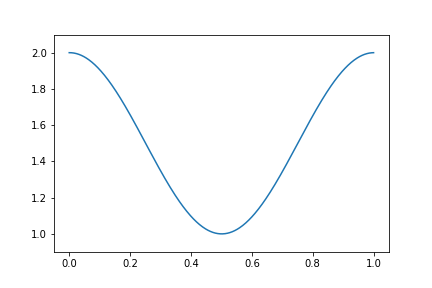

In [21]:
top = 2.1
bottom = 0.9

animation3(1,top,bottom)

In [22]:
def pourLagrange(x_cells,U_cells):
    x = []
    U = []
    for i in range (len(x_cells)-1):
        if x_cells[i] != x_cells[i+1] : 
            x.append(x_cells[i])
            U.append(U_cells[i])
    return x,U

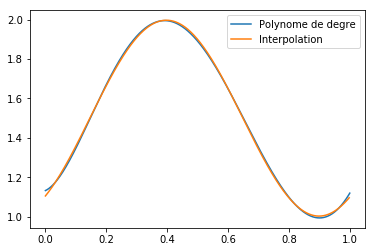

In [23]:
#pour la reconstruction
import scipy.interpolate as spi

x1,U1 = pourLagrange(x_cells,U) 
interp = spi.interp1d(x1,U1)

ap = np.polyfit(x_cells,U,5)

x = np.linspace(0,1,100001)

poly = np.zeros_like(x)

for i in range (len(ap)):
    poly += ap[len(ap)-i-1] * x**i


plt.plot(x,poly,label="Polynome de degre")
plt.plot(x1, interp(x1),label="Interpolation")
plt.legend()
plt.show()